# References:
1. https://www.kaggle.com/code/ekrembayar/store-sales-ts-forecasting-a-comprehensive-guide

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# statistics and machine learning libraries
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from sklearn.preprocessing import LabelEncoder
from scipy.signal import periodogram

# models
from sklearn.linear_model import LinearRegression, Ridge
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from lightgbm import LGBMRegressor
from sklearn.multioutput import MultiOutputRegressor

sns.set_style("whitegrid")
sns.set_theme()

In [2]:
def plot_periodogram(ts, detrend='linear', ax=None):
    fs = pd.Timedelta("1Y") / pd.Timedelta("1D")
    frequencies, spectrum = periodogram(
        ts,
        fs=fs,
        detrend=detrend,
        window='boxcar',
        scaling='spectrum'
    )
    
    if ax is None:
        _, ax = plt.subplots()
        
    ax.step(frequencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
    ax.set_xticklabels([
        "Annual (1)",
        "Semiannual (2)",
        "Quarterly (4)",
        "Bimonthly (6)",
        "Monthly (12)",
        "Biweekly (26)",
        "Weekly (52)",
        "Semiweekly (104)"
    ], rotation=30)
    
    ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    
    return ax

def adfuller_test(timeseries):
    result = adfuller(timeseries, autolag='AIC')
    print(f'ADF Statistics: {result[0]}')
    print(f'p-value: {result[1]}')
    for key, value in result[4].items():
        print('Critical Values:')
        print(f'{key}: {value}')
        
        

# Exploring the Data

In [3]:
plt.rc("figure", autolayout=True, figsize=(11, 5))

In [4]:
work_dir = "dataset\\"

# import data
train = pd.read_csv(work_dir + "train.csv", parse_dates=['date'])
test = pd.read_csv(work_dir + "test.csv", parse_dates=['date'])
stores = pd.read_csv(work_dir + "stores.csv")
transactions = pd.read_csv(work_dir + "transactions.csv", parse_dates=['date'])
oils = pd.read_csv(work_dir + "oil.csv", parse_dates=['date'])
holidays = pd.read_csv(work_dir + "holidays_events.csv", parse_dates=['date'])

# change data type
train['onpromotion'] = train['onpromotion'].astype('float16')
train['sales'] = train['sales'].astype('float32')
stores['cluster'] = stores['cluster'].astype('int8')

In [4]:
train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [7]:
stores.head()

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [8]:
transactions.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [9]:
oils.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [10]:
holidays.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [42]:
print("Total number of stores:", train['store_nbr'].nunique())

Total number of stores: 54


In [43]:
print("Total number of product families:", train['family'].nunique())

Total number of product families: 33


In [47]:
train.describe()

,id,store_nbr,sales,onpromotion
count,3.000888e+06,3.000888e+06,3.000888e+06,3000888.0
mean,1.500444e+06,2.750000e+01,3.577758e+02,NaN
std,8.662819e+05,1.558579e+01,1.101998e+03,NaN
min,0.000000e+00,1.000000e+00,0.000000e+00,0.0
25%,7.502218e+05,1.400000e+01,0.000000e+00,0.0
50%,1.500444e+06,2.750000e+01,1.100000e+01,0.0
75%,2.250665e+06,4.100000e+01,1.958473e+02,0.0
max,3.000887e+06,5.400000e+01,1.247170e+05,741.0


In [48]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype         
---  ------       -----         
 0   id           int64         
 1   date         datetime64[ns]
 2   store_nbr    int64         
 3   family       object        
 4   sales        float32       
 5   onpromotion  float16       
dtypes: datetime64[ns](1), float16(1), float32(1), int64(2), object(1)
memory usage: 108.8+ MB


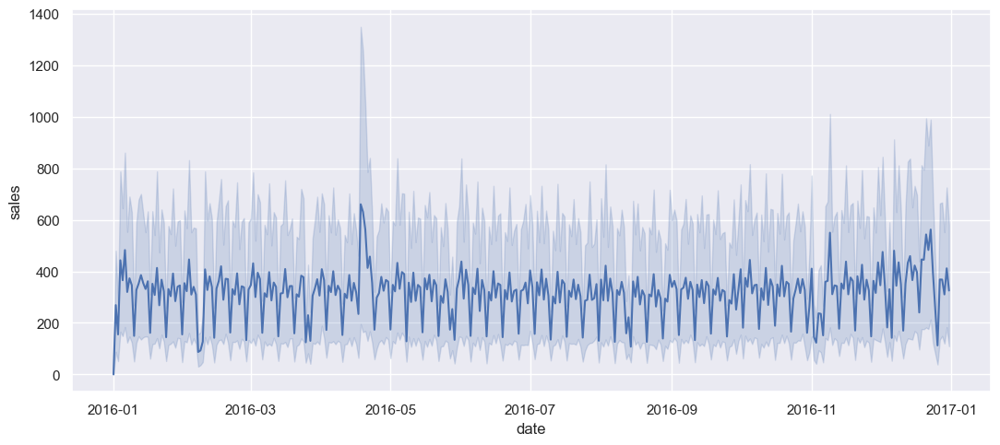

In [5]:
# store 1's sales pattern
sns.lineplot(data=train.loc[(train['store_nbr'] == 1) & (train['date'].dt.year == 2016)], x='date', y='sales')

plt.show()

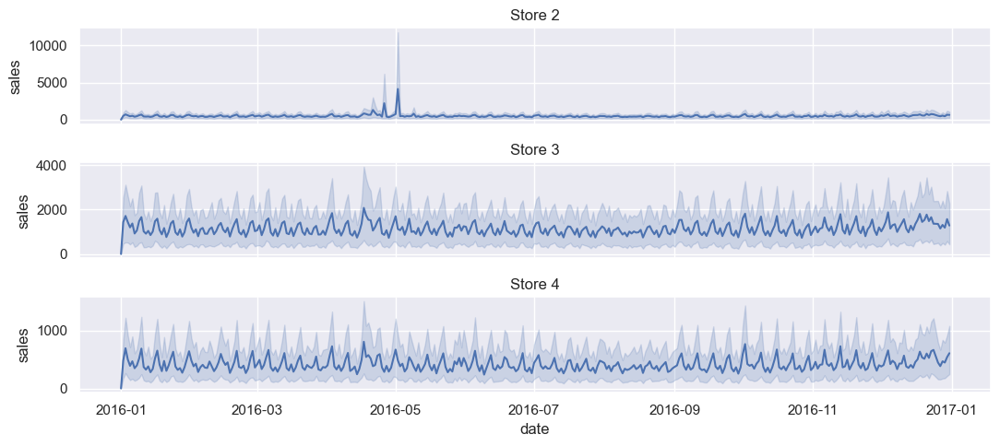

In [6]:
fig, axes = plt.subplots(3, 1, sharex=True)
for i in range(2, 5):
    sub_ax = sns.lineplot(data=train.loc[(train['store_nbr'] == i) & (train['date'].dt.year == 2016)], x='date', y='sales', ax=axes[i - 2])
    sub_ax.set_title("Store " + str(i))
plt.show()

### Interpretation

According to the line charts above, most of the stores have seasonality in the time series of the sales amount.

## Transactions

In [7]:
temp = pd.merge(train.groupby(['date', 'store_nbr'])['sales'].sum().reset_index(), transactions, how='left').fillna(0.0)
print("Spearman Correlation between Total Sales and Transactions: {:,.4}".format(temp.corr("spearman")['sales']['transactions']))

px.line(transactions.sort_values(['store_nbr', 'date']), x='date', y='transactions', color='store_nbr', title="Transactions")


C:\Users\Usrer\AppData\Local\Temp\ipykernel_7872\3357135949.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  print("Spearman Correlation between Total Sales and Transactions: {:,.4}".format(temp.corr("spearman")['sales']['transactions']))


Spearman Correlation between Total Sales and Transactions: 0.8546


There are seasonal pattern in the time series transactions, but for December between 2013 and 2017 there are spikes in increase of the transaction amount. 

In [8]:
temp_a = transactions.copy()
temp_a['year'] = temp_a['date'].dt.year
temp_a['month'] = temp_a['date'].dt.month

fig = px.box(temp_a, x='year', y='transactions', color='month', title="Transactions from 2013 to 2017", labels={"year": "Year", "tranasctions": "Transactions"})
fig.show()

In [9]:
# convert daily to monthly data
temp_b = transactions.set_index('date').resample('M').mean().reset_index()
temp_b['year'] = temp_b['date'].dt.year

fig = px.line(temp_b, x='date', y='transactions', color='year')
fig.show()

There's seasonal trend where the transactions between january and october has seasonality and in december the increase will spike. 

In [11]:
fig = px.scatter(temp, x='transactions', y='sales', trendline='ols', trendline_color_override='red')

fig.show()

Looking at the scatterplot above, there is moderate positive correlation betwee nthe transactions and sales. This means that both variables increase and decrease in the same direction. For example, when transactions increases, the sales also increases and vice versa.

In [12]:
temp_c = transactions.copy()
temp_c['year'] = temp_c['date'].dt.year
temp_c['dayofweek'] = temp_c['date'].dt.dayofweek

In [13]:
fig = px.line(temp_c.groupby(['year', 'dayofweek']).mean(numeric_only=True)['transactions'].reset_index(), x='dayofweek', y='transactions', color='year')
fig.show()

### Interpretation

As shown in the image above, there is some pattern where the transactions went up during weekends. Hence, it has some seasonal pattern in the transactions variable as well. As the total transaction are correlated with the total sales, so the total sales are probably increasing during weekend as well. 

# Oil Price

In [14]:
# resample
oils = oils.set_index('date').resample('D').sum().reset_index()

# interpolate missing values
oils['dcoilwtico'] = np.where(oils['dcoilwtico'] == 0, np.nan, oils['dcoilwtico'])
oils['dcoilwtico_interpolated'] = oils['dcoilwtico'].interpolate()

# plot
p = oils.melt(id_vars=['date'] + list(oils.keys()[5:]), var_name='Legend')
px.line(p.sort_values(['Legend', 'date'], ascending=[False, True]), x='date', y='value', color='Legend', title='Daily Oil Price', labels={"value": "", "date": ""})

In [15]:
temp_d = train.groupby('date')['sales'].mean().reset_index()

px.line(temp_d, x='date', y='sales')

In [16]:
temp_e = pd.merge(train.groupby(['date', 'family'])['sales'].sum().reset_index(), oils.drop('dcoilwtico', axis=1), how='left')
temp_e = temp_e.groupby('family').corr('spearman', numeric_only=True).reset_index()
temp_e = temp_e.loc[temp_e['level_1'] == 'dcoilwtico_interpolated'][['family', 'sales']].sort_values('sales')
temp_f = pd.merge(train, oils.drop('dcoilwtico', axis=1), how='left')

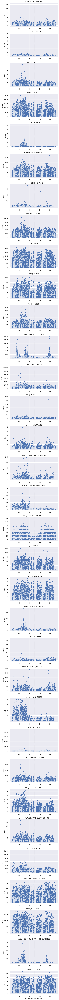

In [17]:
g = sns.FacetGrid(data=temp_f, row='family', aspect=2, sharey=False, sharex=False)
g.map(sns.scatterplot, 'dcoilwtico_interpolated', 'sales')
g.refline(x=70)

### Interpretation

According to the charts above, most of the products has higher sales when the oil price is below 70-75. So, this indicates that when the oil price is lower, the buying power of the customers increase which results in more sales.

# Data Pre-Processing

In [18]:
class Preprocessor:
    # this class generate 2 features set and target for the hybrid model
    def __init__(self, sales, holidays, oils, test_set):
        self.sales = sales.copy() # training set
        self.holidays = holidays.copy()
        self.oils = oils.copy()
        self.test = test_set.copy() # testing set
        
    def generateTrainingFeatures(self):
        # ASSUMPTIONS:
        # the training set's index is set properly
        # the oils dataset is interpolated 
        
        # generate X_1 and X_2 feature sets
        # generate X_1
        fourier = CalendarFourier(freq='Q', order=12)
        dp = DeterministicProcess(
            index=self.sales.unstack(['store_nbr', 'family']).loc['2017'].index, # get training data's 2017 all dates
            constant=True,
            order=1,
            seasonal=True,
            additional_terms=[fourier],
            drop=True
        )
        
        # will be used to generate X features for the testing set
        self.dp = dp
        
        X_1 = dp.in_sample()
        
        # generate X_2
        # holiday features
        holiday_features = self.holidays.set_index('date')
        holiday_features = holiday_features.loc[holiday_features['locale'].isin(['Regional', 'National'])].loc['2017']
        holiday_features = pd.get_dummies(holiday_features[['type', 'locale_name', 'transferred']])
        self.holiday_features = holiday_features # saved for generating testing features
        
        X_2 = pd.merge(pd.DataFrame(pd.date_range('2017-01-01', '2017-08-15')).rename(columns={0: 'date'}), holiday_features, on='date', how='left')
        X_2['transferred'] = np.where(X_2['transferred'] == True, 1, 0)
        X_2 = X_2.set_index('date')
        X_2 = X_2.fillna(0.0)
        
        # promotion features
        onpromotion = self.sales['onpromotion'].reset_index(['store_nbr', 'family'])
        onpromotion = onpromotion.groupby('date').median(numeric_only=True)['onpromotion'].loc['2017']
        
        # oil features
        oils_feature = self.oils.set_index('date').to_period('D').loc['2017']['dcoilwtico_interpolated']
        self.oils_feature = oils_feature # save for generating testing features
        oil_promotion_features = pd.merge(onpromotion, oils_feature, on='date')

        X_2 = X_2.to_period('D').join(oil_promotion_features)
        
        return (X_1, X_2)
    
    def generateTestingFeatures(self):
        if self.dp is None:
            print("Please generate training features first before generating testing features!")
            return
        
        X_1 = self.dp.out_of_sample(steps=16)
        
        # holiday events features
        X_2 = pd.merge(pd.DataFrame(pd.date_range('2017-08-16', '2017-08-31')).rename(columns={0: 'date'}), self.holiday_features, on='date', how='left')
        X_2 = X_2.fillna(0.0) # replaces with 0 if no holidays on the selected period
        X_2 = X_2.set_index('date').to_period('D')

        # oil and promotion features
        onpromotion = self.test[['date', 'onpromotion']].groupby('date').median(numeric_only=True)
        X_2 = X_2.join(pd.merge(onpromotion.to_period('D'), self.oils_feature, on='date'))
        
        return (X_1, X_2)
    
    def generateLabels(self):
        # return pre-processed y
        y = self.sales.unstack(['store_nbr', 'family'])['sales'].loc['2017'] # convert to wide format
        
        return y

In [19]:
# do some loading of the training data and initial set up
store_sales = pd.read_csv(
    work_dir + "train.csv",
    usecols=['store_nbr', 'family', 'date', 'sales', 'onpromotion'],
    dtype={
        'store_nbr': 'category',
        'family': 'category',
        'sales': 'float32',
        'onpromotion': 'float16'
    },
    parse_dates=['date']
)
store_sales['date'] = store_sales['date'].dt.to_period('D')
store_sales = store_sales.set_index(['store_nbr', 'family', 'date']).sort_index()

In [20]:
# generate feature and label variables with the Preprocessor class
preprocessor = Preprocessor(store_sales, holidays, oils, test)
train_X_1, train_X_2 = preprocessor.generateTrainingFeatures()
test_X_1, test_X_2 = preprocessor.generateTestingFeatures()
train_y = preprocessor.generateLabels()

In [109]:
train_X_1.head()

,const,trend,"s(2,7)","s(3,7)","s(4,7)","s(5,7)","s(6,7)","s(7,7)","sin(1,freq=Q-DEC)","cos(1,freq=Q-DEC)",...,"sin(8,freq=Q-DEC)","cos(8,freq=Q-DEC)","sin(9,freq=Q-DEC)","cos(9,freq=Q-DEC)","sin(10,freq=Q-DEC)","cos(10,freq=Q-DEC)","sin(11,freq=Q-DEC)","cos(11,freq=Q-DEC)","sin(12,freq=Q-DEC)","cos(12,freq=Q-DEC)"
date,,,,,,,,,,,,,,,,,,,,,
2017-01-01,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,...,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
2017-01-02,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.069756,0.997564,...,0.529919,0.848048,0.587785,0.809017,0.642788,0.766044,0.694658,0.719340,0.743145,0.669131
2017-01-03,1.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.139173,0.990268,...,0.898794,0.438371,0.951057,0.309017,0.984808,0.173648,0.999391,0.034899,0.994522,-0.104528
2017-01-04,1.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.207912,0.978148,...,0.994522,-0.104528,0.951057,-0.309017,0.866025,-0.500000,0.743145,-0.669131,0.587785,-0.809017
2017-01-05,1.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,0.275637,0.961262,...,0.788011,-0.615661,0.587785,-0.809017,0.342020,-0.939693,0.069756,-0.997564,-0.207912,-0.978148


In [110]:
train_y.head()

store_nbr           1                                                \
family     AUTOMOTIVE BABY CARE BEAUTY BEVERAGES BOOKS BREAD/BAKERY   
date                                                                  
2017-01-01        0.0       0.0    0.0       0.0   0.0     0.000000   
2017-01-02        5.0       0.0    0.0    1434.0   0.0   166.819000   
2017-01-03        4.0       0.0    4.0    3081.0   2.0   519.348022   
2017-01-04        1.0       0.0    4.0    3039.0   2.0   543.250977   
2017-01-05        2.0       0.0    3.0    2617.0   0.0   533.479980   

store_nbr                                            ...         9  \
family     CELEBRATION CLEANING   DAIRY        DELI  ... MAGAZINES   
date                                                 ...             
2017-01-01         0.0      0.0     0.0    0.000000  ...       0.0   
2017-01-02         0.0    332.0   376.0   44.980000  ...       5.0   
2017-01-03        15.0    952.0  1045.0  209.300003  ...       2.0   
2017-01-04        17.0   1055.0  1029.0  135.944000  ...       3.0   
2017-01-05        40.0    918.0   853.0  137.005997  ...       2.0   

store_nbr                                                                  \
family           MEATS PERSONAL CARE PET SUPPLIES PLAYERS AND ELECTRONICS   
date                                                                        
2017-01-01    0.000000           0.0          0.0                     0.0   
2017-01-02  659.570007        1243.0         11.0                    41.0   
2017-01-03  547.364014         876.0          6.0                    15.0   
2017-01-04  395.287994         677.0          6.0                    13.0   
2017-01-05  470.768005         604.0          7.0                    10.0   

store_nbr                                                                      \
family         POULTRY PREPARED FOODS      PRODUCE SCHOOL AND OFFICE SUPPLIES   
date                                                                            
2017-01-01    0.000000       0.000000     0.000000                        0.0   
2017-01-02  843.596008     115.188995  3136.895996                        1.0   
2017-01-03  714.659973     133.039001  3229.558105                        1.0   
2017-01-04  536.830017      75.201004  1491.416992                        7.0   
2017-01-05  414.100006     113.698997  1566.821045                        1.0   

store_nbr           
family     SEAFOOD  
date                
2017-01-01     0.0  
2017-01-02    23.0  
2017-01-03    14.0  
2017-01-04     0.0  
2017-01-05    17.0  

[5 rows x 1782 columns]

### Summary of Pre-Processing

1. Promotion features are created to include onpromotion column into the feature set so that the model can learn the relationship between the onpromotion and the sales to make predictions.
2. Holiday features are also included in the feature set so the model estimate sudden increase in some days where the holidays are placed.
3. As the country is heavily oil-dependent, so the oil price also affect the buying power of the customers. Therefore, the oil feature are also included in the feature set to make predictions
4. First feature (`X_1`) is the trend and seasonal feature that is generated using the fourier features and deterministic process of the `statsmodels` API.

# Model Development

In [21]:
class BoostedHybrid:
    def __init__(self, model_1, model_2):
        self.model_1 = model_1
        self.model_2 = model_2
        self.y_columns = None # stores column names from fit method
        
    def fit(self, X_1, X_2, y):
        self.model_1.fit(X_1, y)
        
        # model's 1 fit and predictions
        y_pred_1 = pd.DataFrame(
            self.model_1.predict(X_1),
            index=X_1.index,
            columns=y.columns
        )
        
        # calculate residuals
        y_residuals = y - y_pred_1
        
        # fit second model with the residuals
        self.model_2.fit(X_2, y_residuals)
        
        # save column names for predict method
        self.y_columns = y.columns
        
    def predict(self, X_1, X_2):
        y_pred_1 = self.model_1.predict(X_1)
        y_pred_2 = self.model_2.predict(X_2)
        y_pred_2 = y_pred_2.clip(0.0) # removes values lesser than 0 by replacing with 0
        
        final_pred = y_pred_1 + y_pred_2
        final_pred = pd.DataFrame(final_pred, index=X_1.index, columns=self.y_columns)
        
        return final_pred
    

# Model Training

In [28]:
model = BoostedHybrid(
    MultiOutputRegressor(Ridge(fit_intercept=False, alpha=0.05)),
    XGBRegressor(
        random_state=42,
        n_estimators=100,
        learning_rate=0.05
    )
)

model.fit(train_X_1, train_X_2, train_y)

In [29]:
train_pred = model.predict(train_X_1, train_X_2).stack(['store_nbr', 'family']).reset_index().rename(columns={'level_0': 'date', 0: 'sales'})
test_pred = model.predict(test_X_1, test_X_2).stack(['store_nbr', 'family']).reset_index().rename(columns={'level_0': 'date', 0: 'sales'})

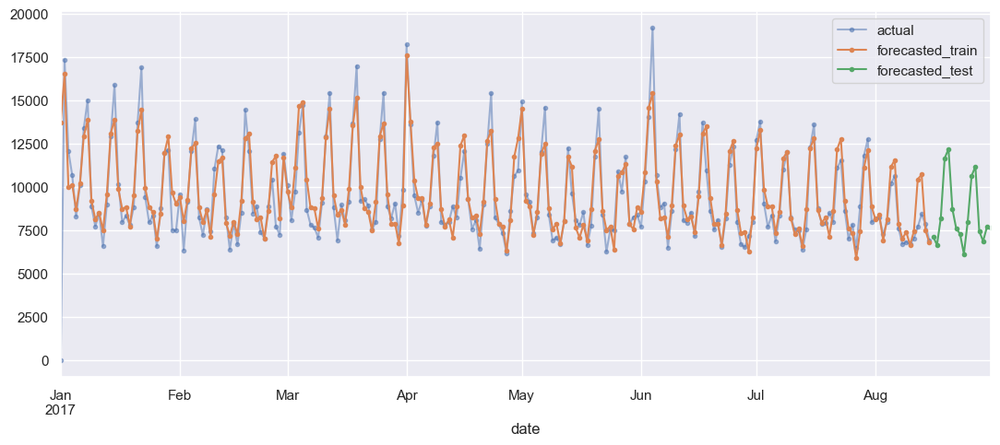

In [30]:
# pick 1 store and 1 family product from that store to visualize whether the forecasted values are accurate
ax = train.loc[(train['store_nbr'] == 3) & (train['family'] == 'BEVERAGES')].set_index('date').loc['2017']['sales'].plot(alpha=0.5, kind='line', style='.-')
ax = train_pred.loc[(train_pred['store_nbr'] == '3') & (train_pred['family'] == 'BEVERAGES')].set_index('date').plot(ax=ax, kind='line', style='.-')
ax = test_pred.loc[(test_pred['store_nbr'] == '3') & (test_pred['family'] == 'BEVERAGES')].set_index('date').plot(ax=ax, kind='line', style='.-')

ax.legend(['actual', 'forecasted_train', 'forecasted_test'])
plt.show()

### Interpretation

There are still some errors in the prediciton as shown in the graph above

# Making submission

In [209]:
pd.concat([test['id'], test_pred[['sales']]], axis=1).to_csv("submission.csv", index=False)